<a href="https://colab.research.google.com/github/tauqueerdanish/Dogs_vs_Cats/blob/main/Dogs_vs_Cats_2.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [1]:
from google.colab import files

In [2]:
files.upload()

Saving kaggle.json to kaggle.json


{'kaggle.json': b'{"username":"tauqueerdanish","key":"956b8bd1d083a0548f52fa3c8ecb222e"}'}

In [3]:
!mkdir ~/.kaggle

In [4]:
! cp kaggle.json ~/.kaggle/

In [5]:
! chmod 600 ~/.kaggle/kaggle.json

In [6]:
!pip install --upgrade --force-reinstall --no-deps kaggle

     |████████████████████████████████| 58 kB 5.1 MB/s 
  Created wheel for kaggle: filename=kaggle-1.5.12-py3-none-any.whl size=73051 sha256=6449faf7e80e26db47569db6a16d24e1e8ec423633e45032f0a2ab6f06f39639
  Stored in directory: /root/.cache/pip/wheels/62/d6/58/5853130f941e75b2177d281eb7e44b4a98ed46dd155f556dc5
Successfully built kaggle
  Attempting uninstall: kaggle
    Found existing installation: kaggle 1.5.12
    Uninstalling kaggle-1.5.12:
      Successfully uninstalled kaggle-1.5.12


In [7]:
import shutil

In [8]:
shutil.rmtree("/content/drive/MyDrive/cats_and_dogs_small_2")

In [9]:
! kaggle competitions download -c dogs-vs-cats

100% 811M/812M [00:21<00:00, 54.7MB/s]
100% 812M/812M [00:21<00:00, 39.2MB/s]


In [10]:
! unzip dogs-vs-cats.zip -d Original_Data

Archive:  dogs-vs-cats.zip
  inflating: Original_Data/sampleSubmission.csv  
  inflating: Original_Data/test1.zip  
  inflating: Original_Data/train.zip  


In [11]:
! unzip /content/Original_Data/train.zip -d all_images
! unzip /content/Original_Data/test1.zip -d all_images

Streaming output truncated to the last 5000 lines.
  inflating: all_images/test1/5499.jpg  
  inflating: all_images/test1/55.jpg  
  inflating: all_images/test1/550.jpg  
  inflating: all_images/test1/5500.jpg  
  inflating: all_images/test1/5501.jpg  
  inflating: all_images/test1/5502.jpg  
  inflating: all_images/test1/5503.jpg  
  inflating: all_images/test1/5504.jpg  
  inflating: all_images/test1/5505.jpg  
  inflating: all_images/test1/5506.jpg  
  inflating: all_images/test1/5507.jpg  
  inflating: all_images/test1/5508.jpg  
  inflating: all_images/test1/5509.jpg  
  inflating: all_images/test1/551.jpg  
  inflating: all_images/test1/5510.jpg  
  inflating: all_images/test1/5511.jpg  
  inflating: all_images/test1/5512.jpg  
  inflating: all_images/test1/5513.jpg  
  inflating: all_images/test1/5514.jpg  
  inflating: all_images/test1/5515.jpg  
  inflating: all_images/test1/5516.jpg  
  inflating: all_images/test1/5517.jpg  
  inflating: all_images/test1/5518.jpg  
  inflatin

In [12]:
import os, shutil
from keras.preprocessing.image import ImageDataGenerator
import matplotlib.pyplot as plt
from tensorflow.keras import models, layers, optimizers

In [13]:
original_data = "/content/all_images/train"
base_dir = "/content/drive/MyDrive/cats_and_dogs_small_2"
os.mkdir(base_dir)

In [14]:
# Making three directories in the cats and dogs small dataset
train_dir = os.path.join(base_dir,"train")
os.mkdir(train_dir)
validation_dir = os.path.join(base_dir,"validation")
os.mkdir(validation_dir)
test_dir = os.path.join(base_dir, "test")
os.mkdir(test_dir)

In [15]:
def make_dir(parent_dir,child_dir):
  path = os.path.join(parent_dir,child_dir)
  os.mkdir(path)
  return path

In [16]:
train_cats_dir = make_dir(train_dir, "cats")
train_dogs_dir = make_dir(train_dir,"dogs")
validation_cats_dir = make_dir(validation_dir,"cats")
validation_dogs_dir = make_dir(validation_dir, "dogs")
test_cats_dir = make_dir(test_dir, "cats")
test_dogs_dir = make_dir(test_dir,"dogs")

In [17]:
def copy_image(state,folder,start,end):
  fnames = [state+".{}.jpg".format(i) for i in range (start,end)]
  for fname in fnames:
    src = os.path.join(original_data,fname)
    dst = os.path.join(folder,fname)
    shutil.copyfile(src,dst)

In [18]:
#Now copy all images from one folder to different folders
copy_image("cat",train_cats_dir,0,1000)
copy_image("dog",train_dogs_dir,0,1000)
copy_image("cat",test_cats_dir,1000,1500)
copy_image("dog",test_dogs_dir,1000,1500)
copy_image("cat",validation_cats_dir,1500,2000)
copy_image("dog",validation_dogs_dir,1500,2000)

In [19]:
print("Total training cat images: ",len(os.listdir(train_cats_dir)))
print("Total training dog images: ",len(os.listdir(train_dogs_dir)))
print("Total test cat images: ",len(os.listdir(test_cats_dir)))
print("Total test dog images: ",len(os.listdir(test_dogs_dir)))
print("Total validation cat images: ",len(os.listdir(validation_cats_dir)))
print("Total validation dog images: ",len(os.listdir(validation_dogs_dir)))

Total training cat images:  1000
Total training dog images:  1000
Total test cat images:  500
Total test dog images:  500
Total validation cat images:  500
Total validation dog images:  500


In [20]:
model  = models.Sequential()
model.add(layers.Conv2D(32, (3,3), activation = "relu", input_shape = (150,150,3)))
model.add(layers.MaxPooling2D(2,2))
model.add(layers.Conv2D(64, (3,3), activation = "relu"))
model.add(layers.MaxPooling2D(2,2))
model.add(layers.Conv2D(128, (3,3), activation = "relu"))
model.add(layers.MaxPooling2D(2,2))
model.add(layers.Conv2D(128,(3,3), activation = "relu"))
model.add(layers.MaxPooling2D(2,2))
model.add(layers.Flatten())
model.add(layers.Dense(512, activation = "relu"))
model.add(layers.Dense(1, activation  = "sigmoid"))

In [21]:
model.summary()

Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv2d (Conv2D)              (None, 148, 148, 32)      896       
_________________________________________________________________
max_pooling2d (MaxPooling2D) (None, 74, 74, 32)        0         
_________________________________________________________________
conv2d_1 (Conv2D)            (None, 72, 72, 64)        18496     
_________________________________________________________________
max_pooling2d_1 (MaxPooling2 (None, 36, 36, 64)        0         
_________________________________________________________________
conv2d_2 (Conv2D)            (None, 34, 34, 128)       73856     
_________________________________________________________________
max_pooling2d_2 (MaxPooling2 (None, 17, 17, 128)       0         
_________________________________________________________________
conv2d_3 (Conv2D)            (None, 15, 15, 128)       1

In [22]:
model.compile(loss = "binary_crossentropy",
              optimizer = ("rmsprop"),
              metrics= ["acc"])

In [23]:
train_datagen = ImageDataGenerator(rescale = 1./255)
test_datagen = ImageDataGenerator(rescale = 1./255)
validation_datagen = ImageDataGenerator(rescale = 1./255)

In [24]:
train_generator = train_datagen.flow_from_directory(train_dir,
                                                    target_size=(150,150),
                                                    batch_size=20,
                                                    class_mode="binary")
validation_generator = validation_datagen.flow_from_directory(validation_dir,
                                                        target_size=(150,150),
                                                        batch_size=20,
                                                        class_mode="binary")

Found 2000 images belonging to 2 classes.
Found 1000 images belonging to 2 classes.


In [25]:
for data_batch,labels_batch in train_generator:
  print("Data batch shape:", data_batch.shape)
  print("Labels batch shape:", labels_batch.shape)
  break

Data batch shape: (20, 150, 150, 3)
Labels batch shape: (20,)


In [26]:
history = model.fit_generator(
    train_generator,
    steps_per_epoch = 100,
    epochs = 30,
    validation_data = validation_generator,
    validation_steps = 50
)

/usr/local/lib/python3.7/dist-packages/keras/engine/training.py:1972: UserWarning: `Model.fit_generator` is deprecated and will be removed in a future version. Please use `Model.fit`, which supports generators.
  warnings.warn('`Model.fit_generator` is deprecated and '


Epoch 1/30
100/100 [==============================] - 46s 155ms/step - loss: 0.7581 - acc: 0.5315 - val_loss: 0.6850 - val_acc: 0.5810
Epoch 2/30
100/100 [==============================] - 16s 157ms/step - loss: 0.6947 - acc: 0.5785 - val_loss: 0.6620 - val_acc: 0.5930
Epoch 3/30
100/100 [==============================] - 16s 156ms/step - loss: 0.6666 - acc: 0.6165 - val_loss: 0.6369 - val_acc: 0.6370
Epoch 4/30
100/100 [==============================] - 15s 154ms/step - loss: 0.6111 - acc: 0.6730 - val_loss: 0.5877 - val_acc: 0.7120
Epoch 5/30
100/100 [==============================] - 16s 156ms/step - loss: 0.5533 - acc: 0.7175 - val_loss: 0.5654 - val_acc: 0.7210
Epoch 6/30
100/100 [==============================] - 15s 154ms/step - loss: 0.5065 - acc: 0.7595 - val_loss: 0.5466 - val_acc: 0.7260
Epoch 7/30
100/100 [==============================] - 15s 155ms/step - loss: 0.4792 - acc: 0.7780 - val_loss: 0.6580 - val_acc: 0.6970
Epoch 8/30
100/100 [==============================] - 1

In [27]:
model.save("cats_and_dogs_small_1.h5")

In [28]:
def plot_map(acc,val_acc,loss,val_loss):
  acc = history.history[acc]
  val_acc = history.history[val_acc]
  loss = history.history[loss]
  val_loss = history.history[val_loss]
  
  epochs = range(1,len(acc)+1)
  plt.plot(epochs,acc,"bo", label = "Training Accuracy")
  plt.plot(epochs,val_acc,"b", label = "Validation Accuracy")
  plt.title("Training and Validation Accuracy")
  plt.legend()
  plt.figure()
  
  
  plt.plot(epochs,loss,"bo", label= "Training Loss")
  plt.plot(epochs, val_loss, "b", label = "Validation Loss")
  plt.title("Training and Validation Loss")
  plt.legend()
  plt.show()

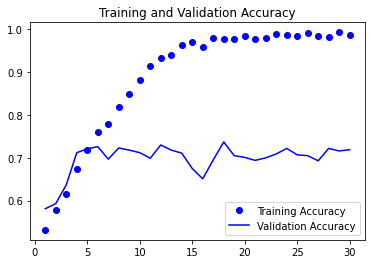

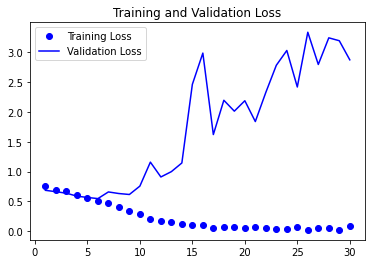

In [29]:
plot_map("acc","val_acc","loss","val_loss")

# **Data Augmentation**

In [30]:
datagen = ImageDataGenerator(
    rotation_range = 40,
    width_shift_range = 0.2,
    height_shift_range = 0.2,
    shear_range = 0.2,
    zoom_range = 0.2,
    horizontal_flip = True,
    fill_mode = "nearest"
)

In [32]:
from keras.preprocessing import image

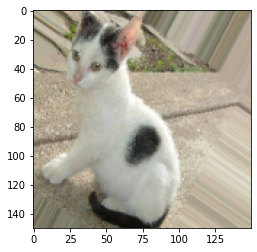

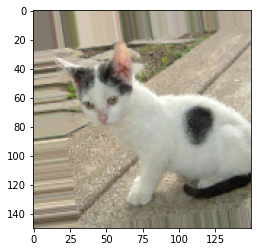

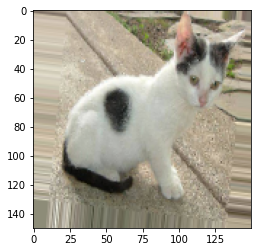

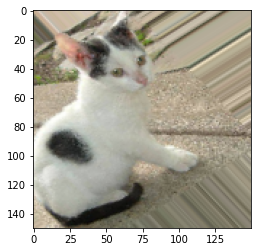

In [33]:
fnames = [os.path.join(train_cats_dir,fname) for fname in os.listdir(train_cats_dir)]
img_path = fnames[3]
img = image.load_img(img_path,target_size= (150,150))
x = image.img_to_array(img)
x = x.reshape((1,)+ x.shape)

i = 0
for  batch in datagen.flow(x, batch_size=1):
  plt.figure(i)
  imgplot = plt.imshow(image.array_to_img(batch[0]))
  i += 1
  if i%4 == 0:
    break

plt.show()

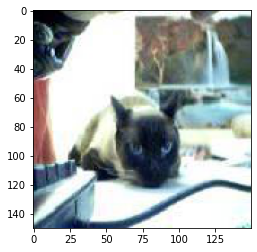

In [34]:
# How we load images and show
test = image.load_img(fnames[5], target_size=(150,150))
imgsh = plt.imshow(test)
plt.show()

In [35]:
# Now cerate a model with the dropout layer which help us to fight the ovrfitting

model  = models.Sequential()
model.add(layers.Conv2D(32, (3,3), activation = "relu", input_shape = (150,150,3)))
model.add(layers.MaxPooling2D(2,2))
model.add(layers.Conv2D(64, (3,3), activation = "relu"))
model.add(layers.MaxPooling2D(2,2))
model.add(layers.Conv2D(128, (3,3), activation = "relu"))
model.add(layers.MaxPooling2D(2,2))
model.add(layers.Conv2D(128,(3,3), activation = "relu"))
model.add(layers.MaxPooling2D(2,2))
model.add(layers.Flatten())
# This dropout layer is just adding in the previous model
model.add(layers.Dropout(0.5))
model.add(layers.Dense(512, activation = "relu"))
model.add(layers.Dense(1, activation  = "sigmoid"))

In [36]:
# Now training the model with the data augmentation generators
train_datagen = ImageDataGenerator(
    rescale= (1./255),
    rotation_range = 40,
    width_shift_range = 0.2,
    height_shift_range = 0.2,
    shear_range = 0.2,
    zoom_range = 0.2,
    horizontal_flip = True
)

validation_datagen = ImageDataGenerator(rescale = (1./255))

In [37]:
train_generator = train_datagen.flow_from_directory(train_dir,
                                                    target_size = (150,150),
                                                    batch_size = 20,
                                                    class_mode= "binary")

validation_generator = validation_datagen.flow_from_directory(validation_dir,
                                                        target_size = (150,150),
                                                        batch_size = 20,
                                                        class_mode = "binary"
                                                        )

Found 2000 images belonging to 2 classes.
Found 1000 images belonging to 2 classes.


In [38]:
model.compile(loss = "binary_crossentropy",
              optimizer = ("rmsprop"),
              metrics= ["acc"])

In [39]:
history = model.fit_generator(
    train_generator,
    steps_per_epoch = 100,
    epochs = 100,
    validation_data = validation_generator,
    validation_steps = 50
)

/usr/local/lib/python3.7/dist-packages/keras/engine/training.py:1972: UserWarning: `Model.fit_generator` is deprecated and will be removed in a future version. Please use `Model.fit`, which supports generators.
  warnings.warn('`Model.fit_generator` is deprecated and '


Epoch 1/100
100/100 [==============================] - 27s 258ms/step - loss: 0.7527 - acc: 0.5170 - val_loss: 0.6987 - val_acc: 0.5150
Epoch 2/100
100/100 [==============================] - 25s 253ms/step - loss: 0.7203 - acc: 0.5180 - val_loss: 0.6841 - val_acc: 0.5410
Epoch 3/100
100/100 [==============================] - 25s 252ms/step - loss: 0.6807 - acc: 0.5840 - val_loss: 0.6604 - val_acc: 0.5890
Epoch 4/100
100/100 [==============================] - 25s 252ms/step - loss: 0.6646 - acc: 0.6180 - val_loss: 0.6448 - val_acc: 0.6440
Epoch 5/100
100/100 [==============================] - 25s 252ms/step - loss: 0.6402 - acc: 0.6340 - val_loss: 0.6508 - val_acc: 0.6080
Epoch 6/100
100/100 [==============================] - 25s 251ms/step - loss: 0.6438 - acc: 0.6450 - val_loss: 0.6538 - val_acc: 0.6110
Epoch 7/100
100/100 [==============================] - 25s 252ms/step - loss: 0.6339 - acc: 0.6495 - val_loss: 0.6156 - val_acc: 0.6600
Epoch 8/100
100/100 [===========================

In [40]:
model.save("cats_and_dogs_small_2.h5")

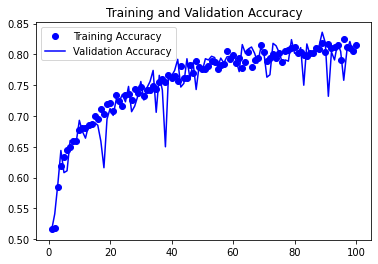

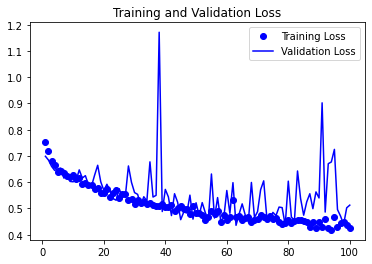

In [41]:
plot_map("acc","val_acc", "loss", "val_loss")

# **Now I use the Pretrained model VGG16 and do features Extraction and Fine Tuning.**
## **VGG16 is trained on imagenet dataset.**

## **Features Extraction**

In [42]:
from keras.applications import vgg16

conv_base = vgg16.VGG16(weights = "imagenet",
                  include_top = False,
                  input_shape = (150,150,3))

# We do not use the dense layer (include_top = False) because vgg16 dense layer has 100 classes but we need only 2 class (cats and dogs)

58900480/58889256 [==============================] - 2s 0us/step


## Now we have two ways to use the Conv_base.
1. we save the output from Conv_base into numpy array and then pass this output to any dense network to get our output. That is a cheap way but we are unable to  use data augmentation in that case.
2. we bing a dense layer with the Conv_base and use data augmentation with that but is an expensive way of training a pretrained model.

# **First Way**

In [43]:
# Extracting features using pretrained Conv_base
import numpy as np


datagen = ImageDataGenerator(rescale = (1./255))
batch_size = 20

def extract_features(directory, sample_count):
  features = np.zeros(shape = (sample_count, 4, 4, 512))  #shape is 4,4,512 because conv_base last layer outputs this shape
  labels = np.zeros(shape = (sample_count,))
  generator = datagen.flow_from_directory(
      directory,
      target_size = (150,150),
      batch_size = batch_size,
      class_mode = "binary"
  )
  i = 0
  for inputs_batch, labels_batch in generator:
    features_batch = conv_base.predict(inputs_batch)
    features[ i * batch_size : (i+1) * batch_size] = features_batch
    labels[ i * batch_size : (i+1) * batch_size] = labels_batch
    i += 1
    if i * batch_size >= sample_count:
      break
    return features, labels

In [44]:
train_feature, train_labels = extract_features(train_dir, 2000)
validation_feature, validation_labels = extract_features(validation_dir, 1000)
test_feature, test_labels = extract_features(test_dir, 1000)

Found 2000 images belonging to 2 classes.
Found 1000 images belonging to 2 classes.
Found 1000 images belonging to 2 classes.


In [45]:
# Now we have train, test and validation features in shape like (sample_count, 4, 4, 512)
# So we must have to flatten them to feed them to dense layer

train_features = np.reshape(train_feature, (2000, 4*4*512))
validation_features =  np.reshape(validation_feature, (1000, 4*4*512))
test_features = np.reshape(test_feature, (1000, 4*4*512))

In [46]:
model = models.Sequential()
model.add(layers.Dense(256, activation= "relu", input_dim = 4*4*512))
model.add(layers.Dropout(0.5))
model.add(layers.Dense(1, activation= "sigmoid"))

In [47]:
model.compile(optimizer= optimizers.RMSprop(learning_rate=2e-5),
              loss = "binary_crossentropy",
              metrics= ["acc"])

In [48]:
history = model.fit(
    train_features,
    train_labels,
    epochs = 30,
    batch_size = 20,
    validation_data = (validation_features, validation_labels)
)

Epoch 1/30
100/100 [==============================] - 1s 7ms/step - loss: 0.6955 - acc: 0.9930 - val_loss: 0.6869 - val_acc: 0.9920
Epoch 2/30
100/100 [==============================] - 0s 5ms/step - loss: 0.6856 - acc: 0.9960 - val_loss: 0.6828 - val_acc: 0.9900
Epoch 3/30
100/100 [==============================] - 1s 5ms/step - loss: 0.6776 - acc: 0.9980 - val_loss: 0.6771 - val_acc: 0.9900
Epoch 4/30
100/100 [==============================] - 1s 6ms/step - loss: 0.6718 - acc: 0.9960 - val_loss: 0.6716 - val_acc: 0.9890
Epoch 5/30
100/100 [==============================] - 1s 6ms/step - loss: 0.6652 - acc: 0.9975 - val_loss: 0.6655 - val_acc: 0.9890
Epoch 6/30
100/100 [==============================] - 1s 6ms/step - loss: 0.6576 - acc: 0.9985 - val_loss: 0.6559 - val_acc: 0.9900
Epoch 7/30
100/100 [==============================] - 1s 5ms/step - loss: 0.6498 - acc: 0.9990 - val_loss: 0.6476 - val_acc: 0.9930
Epoch 8/30
100/100 [==============================] - 0s 5ms/step - loss: 0.

In [49]:
model.save("cats_and_dogs_small_3.h5")

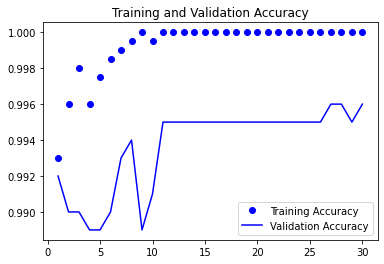

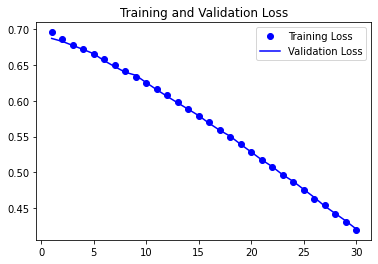

In [50]:
plot_map("acc","val_acc", "loss", "val_loss")

## **Now we have good accuracy but still our model is overfitting. To deal with that case we need data augmentation**

# **Second Way**

In [51]:
model = models.Sequential()
model.add(conv_base)
model.add(layers.Flatten())
model.add(layers.Dense(256, activation='relu'))
model.add(layers.Dense(1, activation='sigmoid'))

In [52]:
 print('This is the number of trainable weights '
'before freezing the conv base:', len(model.trainable_weights))

conv_base.trainable = False
print('This is the number of trainable weights '
'after freezing the conv base:', len(model.trainable_weights))

This is the number of trainable weights before freezing the conv base: 30
This is the number of trainable weights after freezing the conv base: 4


In [53]:
train_datagen = ImageDataGenerator(
            rescale=1./255,
            rotation_range=40,
            width_shift_range=0.2,
            height_shift_range=0.2,
            shear_range=0.2,
            zoom_range=0.2,
            horizontal_flip=True,
            fill_mode='nearest')

validation_datagen = ImageDataGenerator(rescale=1./255)

train_generator = train_datagen.flow_from_directory(
                 train_dir,
                 target_size=(150, 150),
                 batch_size=20,
                 class_mode='binary')
validation_generator = validation_datagen.flow_from_directory(
               validation_dir,
               target_size=(150, 150),
               batch_size=20,
               class_mode='binary')


model.compile(loss='binary_crossentropy',
optimizer=optimizers.RMSprop(lr=2e-5),
metrics=['acc'])




history = model.fit_generator(
train_generator,
steps_per_epoch=100,
epochs=30,
validation_data=validation_generator,
validation_steps=50)

Found 2000 images belonging to 2 classes.
Found 1000 images belonging to 2 classes.


/usr/local/lib/python3.7/dist-packages/keras/optimizer_v2/optimizer_v2.py:356: UserWarning: The `lr` argument is deprecated, use `learning_rate` instead.
  "The `lr` argument is deprecated, use `learning_rate` instead.")
/usr/local/lib/python3.7/dist-packages/keras/engine/training.py:1972: UserWarning: `Model.fit_generator` is deprecated and will be removed in a future version. Please use `Model.fit`, which supports generators.
  warnings.warn('`Model.fit_generator` is deprecated and '


Epoch 1/30
100/100 [==============================] - 31s 301ms/step - loss: 0.5963 - acc: 0.6995 - val_loss: 0.4543 - val_acc: 0.8240
Epoch 2/30
100/100 [==============================] - 30s 296ms/step - loss: 0.4897 - acc: 0.7775 - val_loss: 0.3824 - val_acc: 0.8510
Epoch 3/30
100/100 [==============================] - 29s 294ms/step - loss: 0.4469 - acc: 0.7945 - val_loss: 0.3446 - val_acc: 0.8470
Epoch 4/30
100/100 [==============================] - 29s 295ms/step - loss: 0.4168 - acc: 0.8130 - val_loss: 0.3221 - val_acc: 0.8680
Epoch 5/30
100/100 [==============================] - 30s 295ms/step - loss: 0.3860 - acc: 0.8365 - val_loss: 0.3060 - val_acc: 0.8700
Epoch 6/30
100/100 [==============================] - 29s 294ms/step - loss: 0.3747 - acc: 0.8280 - val_loss: 0.2981 - val_acc: 0.8750
Epoch 7/30
100/100 [==============================] - 29s 293ms/step - loss: 0.3738 - acc: 0.8360 - val_loss: 0.2865 - val_acc: 0.8790
Epoch 8/30
100/100 [==============================] - 2

In [54]:
model.save("cats_and_dogs_small_4.h5")

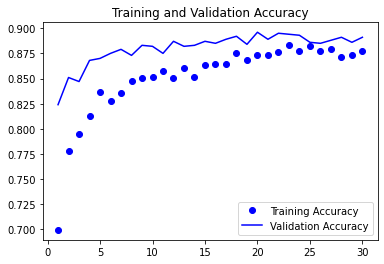

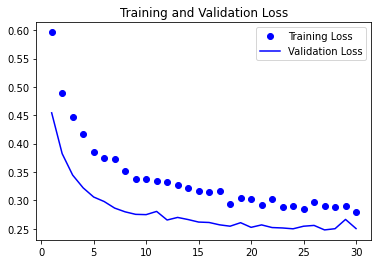

In [55]:
plot_map("acc","val_acc", "loss", "val_loss")

# **FINE TUNNING**

## Now we train some uper layers of the VGG16 to fine tune the model

In [56]:
conv_base.trainable = True

set_trainabale = False

for layer in conv_base.layers:
  if layer.name == "block5_conv1":
    set_trainabale = True
  if set_trainabale:
    layer.trainable = True
  else:
    layer.trainable = False

In [57]:
model.compile(loss = "binary_crossentropy",
              optimizer = optimizers.RMSprop(learning_rate = 1e-5),
              metrics = ["acc"])

In [58]:
history = model.fit_generator(
    train_generator,
    steps_per_epoch = 100,
    epochs = 100,
    validation_data = validation_generator,
    validation_steps = 50
)

/usr/local/lib/python3.7/dist-packages/keras/engine/training.py:1972: UserWarning: `Model.fit_generator` is deprecated and will be removed in a future version. Please use `Model.fit`, which supports generators.
  warnings.warn('`Model.fit_generator` is deprecated and '


Epoch 1/100
100/100 [==============================] - 32s 305ms/step - loss: 0.2979 - acc: 0.8760 - val_loss: 0.2223 - val_acc: 0.9040
Epoch 2/100
100/100 [==============================] - 30s 300ms/step - loss: 0.2692 - acc: 0.8805 - val_loss: 0.2245 - val_acc: 0.9100
Epoch 3/100
100/100 [==============================] - 30s 300ms/step - loss: 0.2392 - acc: 0.8945 - val_loss: 0.2036 - val_acc: 0.9050
Epoch 4/100
100/100 [==============================] - 30s 299ms/step - loss: 0.2190 - acc: 0.8990 - val_loss: 0.2145 - val_acc: 0.9140
Epoch 5/100
100/100 [==============================] - 30s 299ms/step - loss: 0.2150 - acc: 0.9090 - val_loss: 0.2261 - val_acc: 0.9120
Epoch 6/100
100/100 [==============================] - 30s 298ms/step - loss: 0.1974 - acc: 0.9180 - val_loss: 0.1857 - val_acc: 0.9200
Epoch 7/100
100/100 [==============================] - 30s 298ms/step - loss: 0.1953 - acc: 0.9160 - val_loss: 0.1932 - val_acc: 0.9250
Epoch 8/100
100/100 [===========================

In [59]:
model.save("cats_and_dogs_small_5.h5")

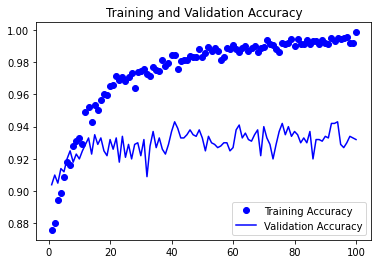

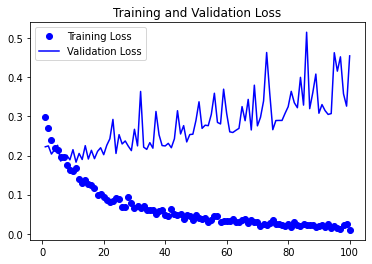

In [60]:
plot_map("acc","val_acc", "loss", "val_loss")

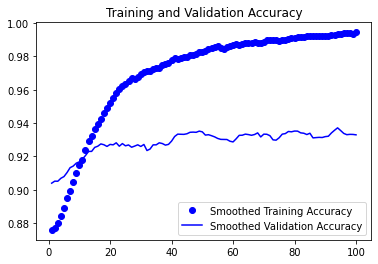

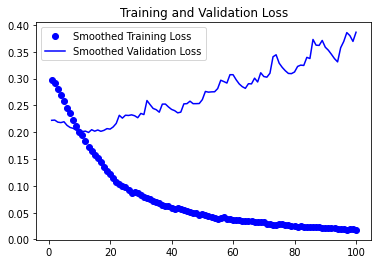

In [66]:
def smooth_curve(points, factor=0.8):
  smoothed_points = []
  for point in points:
    if smoothed_points:
      previous = smoothed_points[-1]
      smoothed_points.append(previous * factor + point * (1 - factor))
    else:
      smoothed_points.append(point)
  return smoothed_points

acc = history.history["acc"]
val_acc = history.history["val_acc"]
loss = history.history["loss"]
val_loss = history.history["val_loss"]

#epochs = range(1,len(acc)+1)
plt.plot(epochs,smooth_curve(acc),"bo", label = "Smoothed Training Accuracy")
plt.plot(epochs,smooth_curve(val_acc),"b", label = "Smoothed Validation Accuracy")
plt.title("Training and Validation Accuracy")
plt.legend()
plt.figure()


plt.plot(epochs,smooth_curve(loss),"bo", label= "Smoothed Training Loss")
plt.plot(epochs,smooth_curve(val_loss), "b", label = "Smoothed Validation Loss")
plt.title("Training and Validation Loss")
plt.legend()
plt.show()

# **Now Finally we are going to evaluate the model** 

In [68]:
test_generator = test_datagen.flow_from_directory(
    test_dir,
    target_size= (150,150),
    batch_size = 20,
    class_mode = "binary"
)

test_loss, test_acc = model.evaluate_generator(test_generator, steps=50)
print("test_acc:",test_acc)

Found 1000 images belonging to 2 classes.


/usr/local/lib/python3.7/dist-packages/keras/engine/training.py:2006: UserWarning: `Model.evaluate_generator` is deprecated and will be removed in a future version. Please use `Model.evaluate`, which supports generators.
  warnings.warn('`Model.evaluate_generator` is deprecated and '


test_acc: 0.9279999732971191


# **Now, we are going to visualize what the convnets actually learn**

### **There are many techniques to visualize the convnets but we just mention only three here**


1.   Visualize intermediate convnet outputs
2.   Visualizing convnets filter
3.   Visualizing heatmaps of class activation in an image



### **1.Visualize intermediate convnets outputs** 

In [69]:
from keras.models import load_model

In [72]:
model = load_model("cats_and_dogs_small_2.h5")
model.summary()

Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv2d_4 (Conv2D)            (None, 148, 148, 32)      896       
_________________________________________________________________
max_pooling2d_4 (MaxPooling2 (None, 74, 74, 32)        0         
_________________________________________________________________
conv2d_5 (Conv2D)            (None, 72, 72, 64)        18496     
_________________________________________________________________
max_pooling2d_5 (MaxPooling2 (None, 36, 36, 64)        0         
_________________________________________________________________
conv2d_6 (Conv2D)            (None, 34, 34, 128)       73856     
_________________________________________________________________
max_pooling2d_6 (MaxPooling2 (None, 17, 17, 128)       0         
_________________________________________________________________
conv2d_7 (Conv2D)            (None, 15, 15, 128)      

In [75]:
img_path = "/content/cats2.jpg" 
from keras.preprocessing import image
import numpy as np
img = image.load_img(img_path, target_size = (150,150))
img_tensor = image.img_to_array(img)
img_tensor = np.expand_dims(img_tensor, axis=0)
img_tensor /= 255
print(img_tensor.shape)

(1, 150, 150, 3)


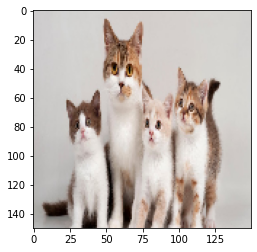

In [76]:
#Now display the image
plt.imshow(img_tensor[0])
plt.show()

In [78]:
layers_output = [layer.output for layer in model.layers[:8]]
activation_model = models.Model(inputs= model.input, outputs = layers_output)

In [79]:
activations = activation_model.predict(img_tensor)

In [86]:
first_layer_activation = activations[0]
print(first_layer_activation.shape)

(1, 148, 148, 32)


### It’s a 148 × 148 feature map with 32 channels. Let’s try plotting the fourth channel of the activation of the first layer of the original model

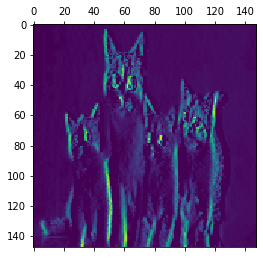

In [88]:
plt.matshow(first_layer_activation[0,:,:,4], cmap= "viridis")

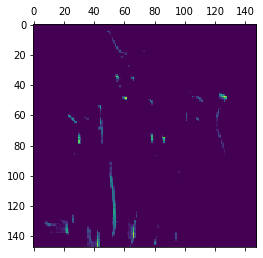

In [89]:
# Now let's try the seventh chanel
plt.matshow(first_layer_activation[0, :, :, 7], cmap='viridis')

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:16: RuntimeWarning: invalid value encountered in true_divide
  app.launch_new_instance()
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:24: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


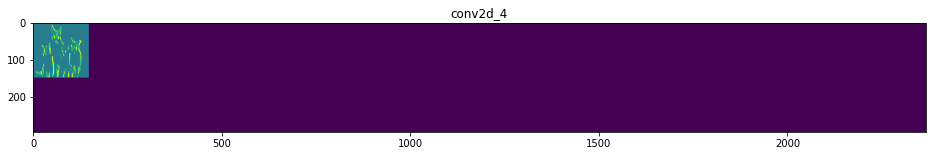

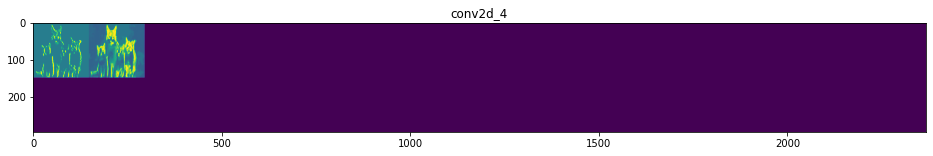

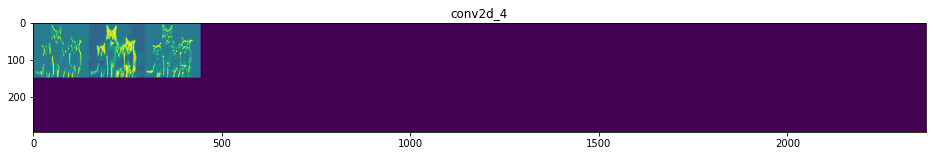

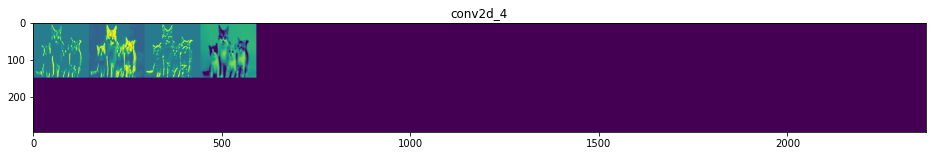

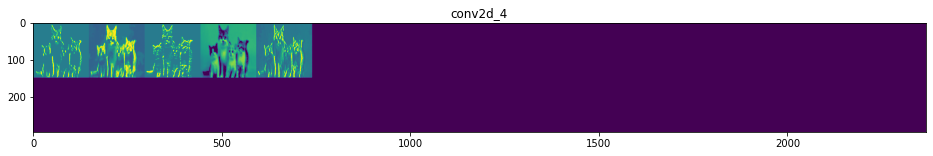

...

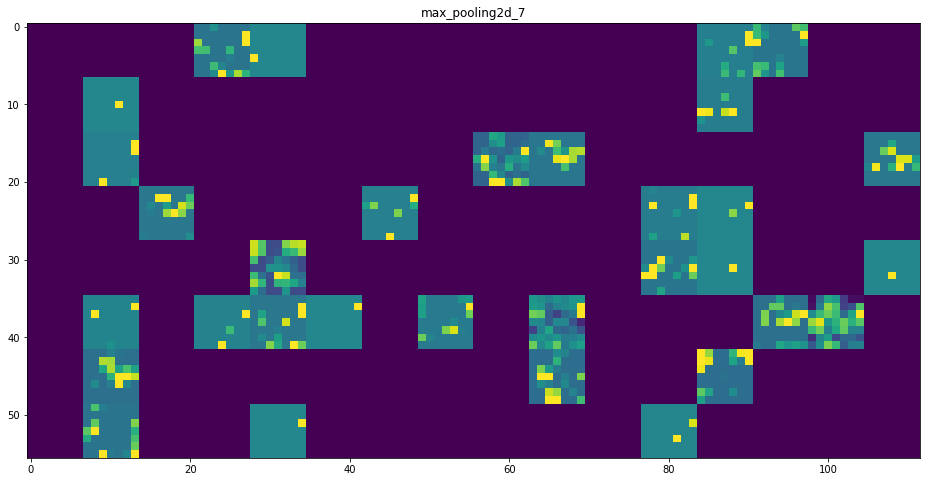

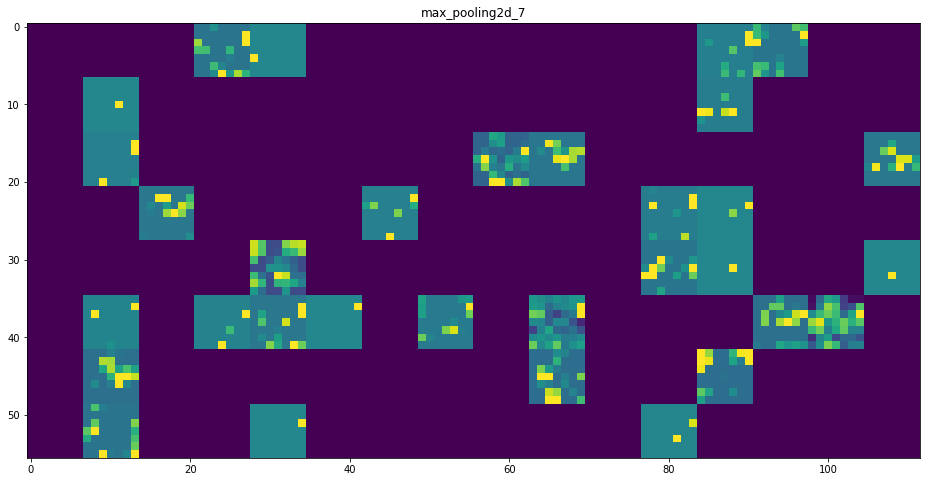

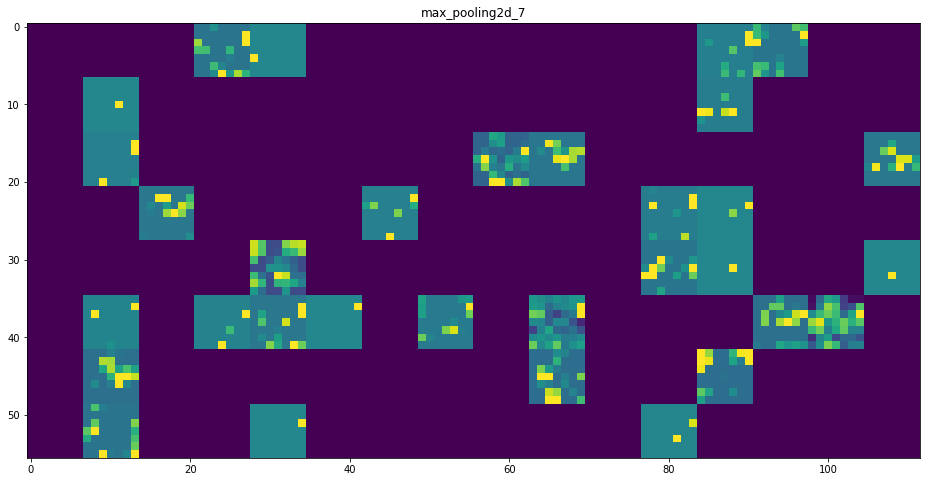

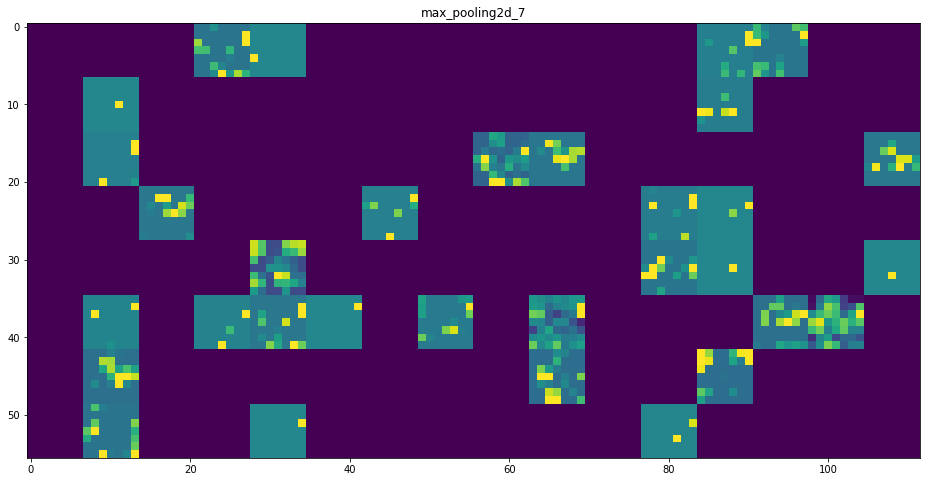

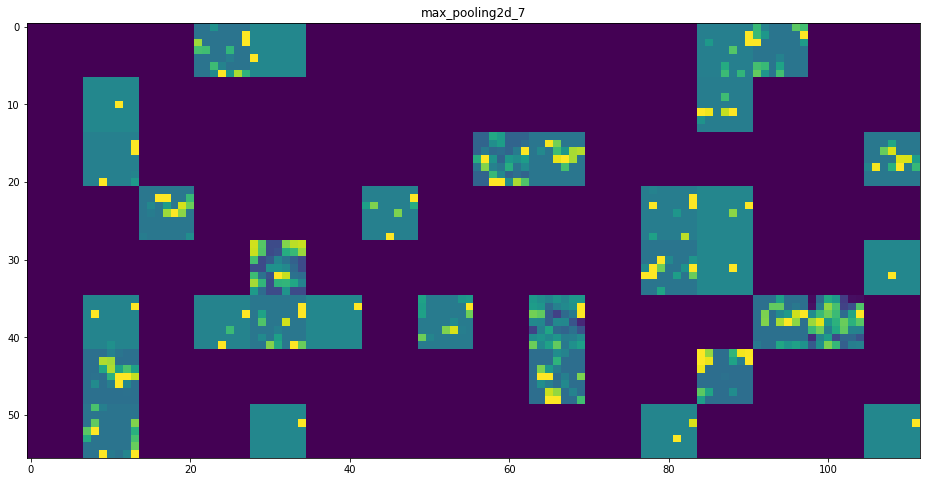

In [93]:
#Now we visualize all the layers in one window
layer_names = []
for layer in model.layers[:8]:
  layer_names.append(layer.name)

images_per_row = 16
for layer_name, layer_activation in zip(layer_names, activations):
  n_features = layer_activation.shape[-1]
  size = layer_activation.shape[1]
  n_cols = n_features // images_per_row
  display_grid = np.zeros((size * n_cols, images_per_row * size))
  for col in range(n_cols):
    for row in range(images_per_row):
      channel_image = layer_activation[0,:,:,col * images_per_row + row]
      channel_image -= channel_image.mean()
      channel_image /= channel_image.std()
      channel_image *= 64
      channel_image += 128
      channel_image = np.clip(channel_image, 0 , 255).astype("uint8")
      display_grid[col*size : (col + 1) * size,
                   row * size : (row + 1)* size] = channel_image
      scale = 1. / size
      plt.figure(figsize= (scale * display_grid.shape[1],
                            scale * display_grid.shape[0]))
      plt.title(layer_name)
      plt.grid(False)
      plt.imshow(display_grid, aspect= "auto", cmap= "viridis")



## **2. Visualizing convnet features**

In [101]:
from tensorflow.keras import backend as K

In [102]:
# To inspect the convnet features we need to do the gradient descent of the loss function
# To perform this first we try this on a layer "layer3_conv1"
from tensorflow.keras.applications import VGG16
import tensorflow as tf

tf.compat.v1.disable_eager_execution()


model = VGG16(weights = "imagenet",
              include_top = False)
layer_name = "block3_conv1"
filter_index = 0
layer_output = model.get_layer(layer_name).output
loss = K.mean(layer_output[ :, :, :, filter_index])



# To implement the gradient descent we need the gradient of this loss
grads = K.gradients(loss, model.input)[0]

In [104]:
# To make gradient descent step goes smooth we use L2 norm method (taking square root of the average of the  square of values)
# We add the value with " 1e-5 " to save value divide by zero
grads /= (K.sqrt(K.mean(K.square(grads))) + 1e-5)

In [105]:

# Now we need to compute the value of loss tensor and gradient tensor
# We use keras backend function " Iterate " it takes one input (numpy tensor) and give two outputs (loss value, gradient value)

iterate = K.function([model.input], [loss, grads])
loss_value, grads_value = iterate([np.zeros((1, 150, 150, 3))])

In [107]:
# Now we do Stochastic gradient descent (Stochastic gradient descent just smoothens the value of the gradient descent)

input_image_data = np.random.random((1, 150, 150, 3)) * 20 + 128
step = 1.
for i in range(40):
  loss_value, grad_value = iterate([input_image_data])
  input_image_data += grads_value * step

In [108]:
# The resulting value may not be in range from [1, 255]. so, we need to preprocess the tensor so that we can show it in a presentable form
# We do so using thiis utility functon

def deprocess_image(x):
  x -= x.mean()
  x /= (x.std() + 1e-5)
  x *= 0.1
  
  x += 0.5
  x = np.clip(x, 0, 1)

  x *= 255
  x = np.clip(x, 0, 255).astype("uint8")
  return x


In [114]:
def generate_pattern(layer_name, filter_index, size= 150):
  layer_output = model.get_layer(layer_name).output
  loss = K.mean(layer_output[:, :, :, filter_index])
  grads = K.gradients(loss, model.input)[0]
  grads /= (K.sqrt(K.mean(K.square(grads)))) + 1e-5
  iterate = K.function([model.input], [loss, grads])
  input_img_data = np.random.random((1, size, size, 3)) *20 +128
  step = 1
  for i in range(40):
    loss_value, grads_value = iterate([input_img_data])
    input_img_data += grads_value * step
  
  img = input_img_data[0]
  return deprocess_image(img)

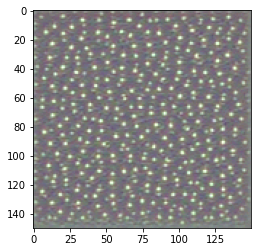

In [115]:
plt.imshow(generate_pattern("block3_conv1", 0))

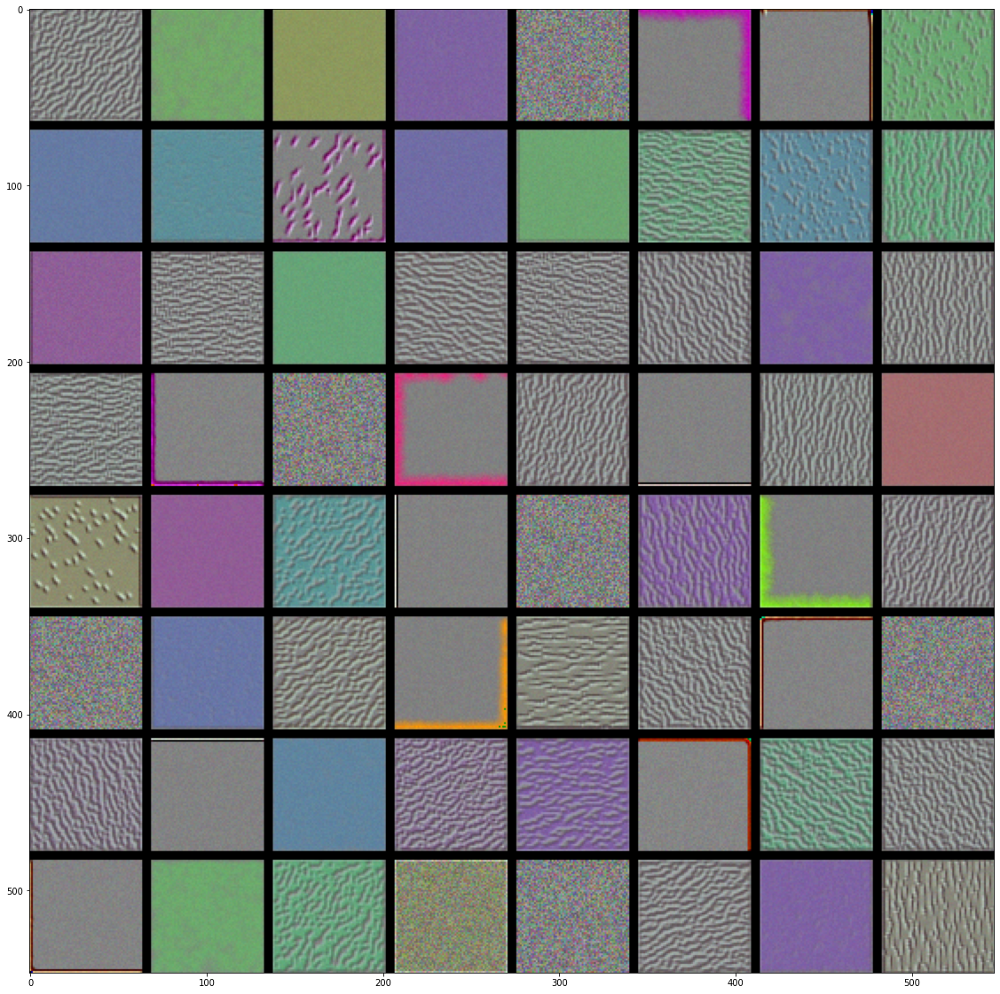

In [121]:
# Generating a grid of all filter patterns of a layer
layer_name = "block1_conv1"
size = 64
margin = 5

results = np.zeros((8 * size + 7 * margin, 8 * size + 7 * margin, 3))

for i in range(8):
  for j in range(8):
    filter_img = generate_pattern(layer_name, i + ( j * 8 ), size= size)
    horizontal_start = i * size + i * margin
    horizontal_end = horizontal_start + size
    vertical_start = j * size + j * margin
    vertical_end = vertical_start + size
    results[horizontal_start : horizontal_end, vertical_start : vertical_end, : ] = filter_img
plt.figure(figsize = ( 20 , 20 ))
plt.imshow((results * 255).astype(np.uint8))

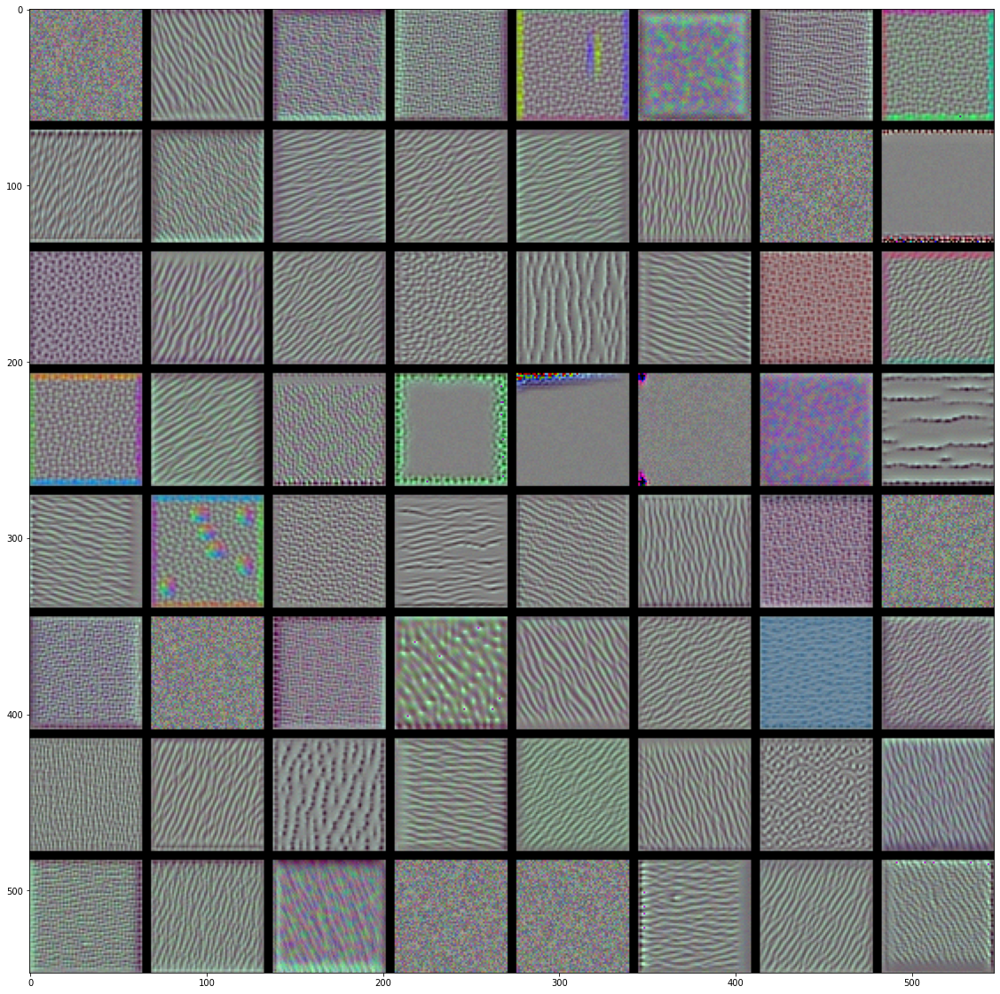

In [123]:
# Generating a grid of all filter patterns of a layer
layer_name = "block2_conv1"
size = 64
margin = 5

results = np.zeros((8 * size + 7 * margin, 8 * size + 7 * margin, 3))

for i in range(8):
  for j in range(8):
    filter_img = generate_pattern(layer_name, i + ( j * 8 ), size= size)
    horizontal_start = i * size + i * margin
    horizontal_end = horizontal_start + size
    vertical_start = j * size + j * margin
    vertical_end = vertical_start + size
    results[horizontal_start : horizontal_end, vertical_start : vertical_end, : ] = filter_img
plt.figure(figsize = ( 20 , 20 ))
plt.imshow((results * 255).astype(np.uint8))

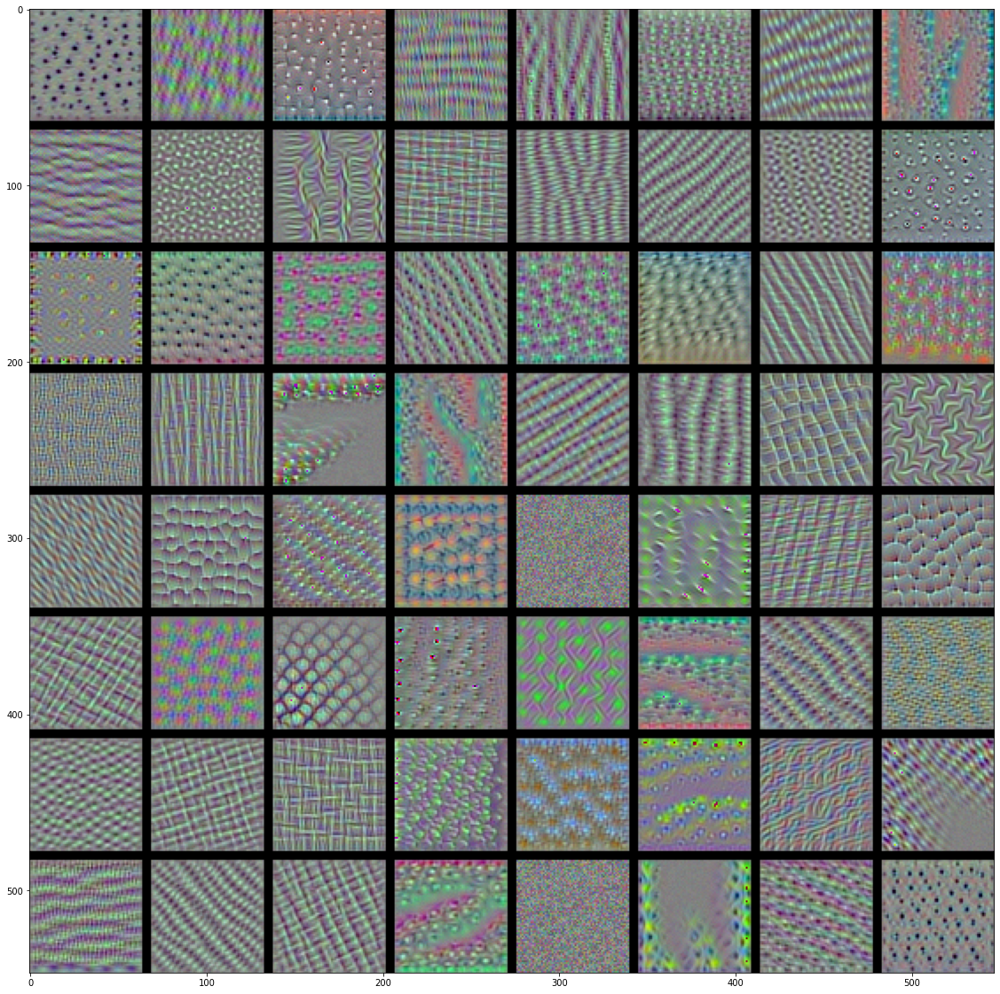

In [124]:
# Generating a grid of all filter patterns of a layer
layer_name = "block3_conv1"
size = 64
margin = 5

results = np.zeros((8 * size + 7 * margin, 8 * size + 7 * margin, 3))

for i in range(8):
  for j in range(8):
    filter_img = generate_pattern(layer_name, i + ( j * 8 ), size= size)
    horizontal_start = i * size + i * margin
    horizontal_end = horizontal_start + size
    vertical_start = j * size + j * margin
    vertical_end = vertical_start + size
    results[horizontal_start : horizontal_end, vertical_start : vertical_end, : ] = filter_img
plt.figure(figsize = ( 20 , 20 ))
plt.imshow((results*255).astype(np.uint8))

# **Visualizing heatmaps  of class activation**

## This technique is also called CAM (Class Activation Map)

In [125]:
# We use this technique again with the VGG16 pretrained model

model = VGG16(weights= "imagenet")     #Now we also included the dense layer of the network but in all above cases we discarded it.

553476096/553467096 [==============================] - 14s 0us/step


In [129]:
# The vgg16 is trained on the images of size 224 * 224. so, we need to resize the image to 224*224 and convert into numpy float tensor
#Preprocessing the input image

from keras.applications.vgg16 import preprocess_input, decode_predictions
img_path = "/content/cats2.jpg"
img = image.load_img(img_path, target_size = (224, 224))
x = image.img_to_array(img)
x = np.expand_dims(x, axis= 0)
x = preprocess_input(x)

In [130]:
# Now we run that pretrained network on the image and decode it's prediction vector into human readable format
preds = model.predict(x)
print("Predicted:", decode_predictions(preds, top= 3)[0])

/usr/local/lib/python3.7/dist-packages/keras/engine/training.py:2470: UserWarning: `Model.state_updates` will be removed in a future version. This property should not be used in TensorFlow 2.0, as `updates` are applied automatically.
  warnings.warn('`Model.state_updates` will be removed in a future version. '


49152/35363 [=========================================] - 0s 0us/step
Predicted: [('n02124075', 'Egyptian_cat', 0.39638108), ('n02123045', 'tabby', 0.09861399), ('n02109961', 'Eskimo_dog', 0.064986065)]


In [131]:
np.argmax(preds[0])

285

In [132]:
# Now we visualize which parts are most likely the predicted class by using the GRAD-CAM process
cat_output = model.output[:, 285]
last_conv_layer = model.get_layer("block5_conv3")  #Output  the last conv layer of vgg16 model

#gradient of the "Egyptian_cat" class with regard to the output feature map of block5_conv3
grads = K.gradients(cat_output, last_conv_layer.output)[0]

#vector of shape(512), where each intensity is the mean intensity of the gradient over a specific feature-map channel
pooled_grads = K.mean(grads, axis=(0, 1, 2))

#let's you access the quantities you just defined,
# Pooled_grads and output feature map of block5_conv3, given a sample image
iterate = K.function([model.input], [pooled_grads, last_conv_layer.output[0]])

#values of these two quantities, as numpy arrays, given the sample image of cats
pooled_grads_value, conv_layer_output_value = iterate([x])

#multiplies each channel in the feature-map array by "how important this channel is" with regard to "cat" class 
for i in range(512):
  conv_layer_output_value[:, :, i] *= pooled_grads_value[i]

# The channel-wise mean of the resulting feature-map is the heatmap of the class activation 
heatmap = np.mean(conv_layer_output_value, axis = -1)




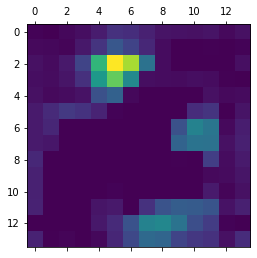

In [133]:
# For visualization purpose we need to normalize the heatmpap between 0 and 1

heatmap = np.maximum(heatmap, 0)
heatmap /= np.max(heatmap)
plt.matshow(heatmap)

In [135]:
# Now we use opencv to generate image of that superimposes the original image on the heatmap you just obtained

import cv2
img = cv2.imread(img_path)
heatmap = cv2.resize(heatmap, (img.shape[1], img.shape[0]))
heatmap = np.uint8(255 * heatmap)
heatmap = cv2.applyColorMap(heatmap, cv2.COLORMAP_JET)
superimposed_img = heatmap * 0.4 + img
cv2.imwrite("/content/cats_heatmap_1.jpg", superimposed_img)

True

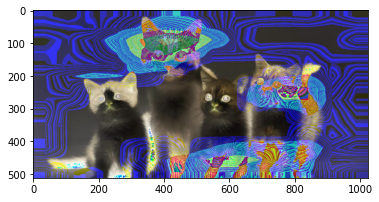

In [138]:
plt.imshow((superimposed_img * 255).astype(np.uint8))